In [2]:
# Import dependencies

import torch
import torchvision
import matplotlib.pyplot as plt
import torch.nn as nn
from torchvision import transforms

try:
  from torchinfo import summary
except:
  print(f"[INFO] torchinfo not found. Installing...")
  !pip install -q torchinfo
  from torchinfo import summary
try:
  from going_modular.going_modular import data_setup, engine
except:
  print(f"[INFO] Couldn't find going modular scripts...downloading...")
  !git clone https://github.com/mrdbourke/pytorch-deep-learning
  !mv pytorch-deep-learning/going_modular .
  !rm -rf pytorch-deep-learning
  from going_modular.going_modular import data_setup, engine


[INFO] torchinfo not found. Installing...
[INFO] Couldn't find going modular scripts...downloading...
Cloning into 'pytorch-deep-learning'...
remote: Enumerating objects: 4177, done.
remote: Counting objects: 100% (142/142), done.
remote: Compressing objects: 100% (102/102), done.
remote: Total 4177 (delta 62), reused 103 (delta 39), pack-reused 4035 (from 1)
Receiving objects: 100% (4177/4177), 651.42 MiB | 32.07 MiB/s, done.
Resolving deltas: 100% (2433/2433), done.
Updating files: 100% (248/248), done.


In [3]:
device = "cuda" if torch.cuda.is_available() else "cpu"
device

'cpu'

In [4]:
# set seeds
def set_seeds(seed: int=42):
  torch.manual_seed(seed)
  torch.cuda.manual_seed(42)

In [5]:
# get data
import os
import zipfile
from pathlib import Path
import requests


def download_data(source:str,
                  destination: str,
                  remove_source: bool=True) -> Path:
                  # setup path to data folder
                  data_path = Path("data/")
                  image_path = data_path / destination
                  # Download image folder if it doesn't exist
                  if image_path.is_dir():
                    print(f"[INFO] {image_path} directory exists, skippping download")
                  else:
                    print(f"[INFO] Did not find {image_path} directory, creating one...")
                    image_path.mkdir(parents=True, exist_ok=True)

                    # download data
                    target_file = Path(source).name
                    with open(data_path / target_file, "wb") as f:
                      request = requests.get(source)
                      print(f"[INFO] Downloading {target_file} from {source}")
                      f.write(request.content)

                    # Unzipping the data
                    with zipfile.ZipFile(data_path / target_file, "r") as zipref:
                      print(f"[INFO] Unzipping {target_file} data...")
                      zipref.extractall(image_path)

                    # remove .zipfile
                    if remove_source:
                      os.remove(data_path / target_file)

                    return image_path
image_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                           destination="pizza_steak_sushi")

image_path

[INFO] Did not find data/pizza_steak_sushi directory, creating one...
[INFO] Downloading pizza_steak_sushi.zip from https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip
[INFO] Unzipping pizza_steak_sushi.zip data...


PosixPath('data/pizza_steak_sushi')

In [6]:
# get auto transforms

# setup dirs
train_dir = image_path / "train"
test_dir = image_path / "test"

# Setup pretrained weights
weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT

# Get transforms from weights
auto_transforms = weights.transforms()

# Create dataloaders
train_dataloader, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir = train_dir,
    test_dir = test_dir,
    transform = auto_transforms,
    batch_size = 32
)

train_dataloader, test_dataloader, class_names

(<torch.utils.data.dataloader.DataLoader at 0x7aa467d76890>,
 ['pizza', 'steak', 'sushi'])

In [7]:
# Get pretrained model
model = torchvision.models.efficientnet_b0(weights=weights).to(device)

model

Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 94.2MB/s]


EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

In [8]:
# Freeeze all base layers
for param in model.features.parameters():
  param.requires_grad = False

# set seeds
set_seeds()

# Update classifier head
model.classifier = torch.nn.Sequential(
    nn.Dropout(p=0.2, inplace=True),
nn.Linear(in_features=1280,
          out_features=len(class_names),
          bias=True).to(device)
)

In [9]:
# get summary of the model

summary(model,
        input_size=(32,3,224,224),
        verbose=0,
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width = 20,
        row_settings=["var_names"])

Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [10]:
# define loss and optimizer
loss_fn = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)


In [11]:
try:
  from torch.utils.tensorboard import SummaryWriter
except:
  print("[INFO] Tensorboard not found...installing")
  !pip install -q tensorboard
  from torch.utils.tensorboard import SummaryWriter


# Create a writer with all default settings
writer = SummaryWriter()

In [12]:
# tracking  the model results
from typing import Dict, List
from tqdm.auto import tqdm

from going_modular.going_modular.engine import train_step, test_step

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device) -> Dict[str, List]:
          # Create empty results dictionary
          results = {"train_loss": [],
                     "train_acc": [],
                     "test_loss": [],
                     "test_acc": []
                     }
          for epoch in tqdm(range(epochs)):
            train_loss, train_acc = train_step(model=model,
                                               dataloader=train_dataloader,
                                               loss_fn=loss_fn,
                                               optimizer=optimizer,
                                               device=device)
            test_loss, test_acc = test_step(model=model,
                                            dataloader=test_dataloader,
                                            loss_fn=loss_fn,
                                            device = device
                                            )

            print(
                f"Epoch: {epoch+1} | "
                f"train_loss: {train_loss:.4f} | "
                f"train_acc: {train_acc:.4f} | "
                f"test_loss: {test_loss:.4f} | "
                f"test_acc: {test_acc:.4f} | "
            )

            # Update results dictionary
            results["train_loss"].append(train_loss)
            results["train_acc"].append(train_acc)
            results["test_loss"].append(test_loss)
            results["test_acc"].append(test_acc)

            # Experiment tracking
            # Add loss results to SummaryWriter
            writer.add_scalars(main_tag="Loss",
                               tag_scalar_dict={"train_loss": train_loss,
                                                "test_loss": test_loss},
                               global_step=epoch)

            # Add accuracy results to SummaryWriter
            writer.add_scalars(main_tag="Accuracy",
                               tag_scalar_dict={"train_acc": train_acc,
                                                "test_acc": test_acc},
                               global_step=epoch)

            # Track the model architecture
            writer.add_graph(model=model,
                            #  Pass in an example inpuy
                             input_to_model=torch.randn(32,3,224,224).to(device))

            # Close the writer
          writer.close()


          return results

In [13]:
# Train model
set_seeds()

results = train(model=model,
                train_dataloader=train_dataloader,
                test_dataloader=test_dataloader,
                optimizer=optimizer,
                loss_fn=loss_fn,
                epochs=5,
                device=device)

  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 1.0966 | train_acc: 0.3867 | test_loss: 0.8843 | test_acc: 0.6828 | 
Epoch: 2 | train_loss: 0.9204 | train_acc: 0.6445 | test_loss: 0.8134 | test_acc: 0.7746 | 
Epoch: 3 | train_loss: 0.7602 | train_acc: 0.8750 | test_loss: 0.6562 | test_acc: 0.8864 | 
Epoch: 4 | train_loss: 0.6868 | train_acc: 0.7695 | test_loss: 0.6201 | test_acc: 0.8759 | 
Epoch: 5 | train_loss: 0.6467 | train_acc: 0.7969 | test_loss: 0.6054 | test_acc: 0.8665 | 


In [14]:
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

In [15]:
# Create a helper function to build SummaryWriter()

def create_writer(experiment_name: str,
                  model_name: str,
                  extra: str=None) -> torch.utils.tensorboard.writer.SummaryWriter():
                  from datetime import datetime
                  import os

                  # Get timestamp of current date
                  timestamp = datetime.now().strftime("%Y-%m-%d")

                  if extra:
                    # Create log directory path
                    log_dir = os.path.join("runs", timestamp, experiment_name, model_name, extra)
                  else:
                    log_dir = os.path.join("runs", timestamp, experiment_name, model_name)

                  print(f"[INFO] Created SummaryWriter, saving to: {log_dir}...")
                  return SummaryWriter(log_dir=log_dir)

In [16]:
# Create an example writer
example_writer = create_writer(experiment_name="data_10_percent",
                               model_name="effnetb0",
                               extra="5_epochs")


[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_10_percent/effnetb0/5_epochs...


In [27]:
# Update train() function to include a writer parameter
# tracking  the model results
from typing import Dict, List
from tqdm.auto import tqdm

from going_modular.going_modular.engine import train_step, test_step

def train(model: torch.nn.Module,
          train_dataloader: torch.utils.data.DataLoader,
          test_dataloader: torch.utils.data.DataLoader,
          optimizer: torch.optim.Optimizer,
          loss_fn: torch.nn.Module,
          epochs: int,
          device: torch.device,
          writer: torch.utils.tensorboard.writer.SummaryWriter) -> Dict[str, List]:
          # Create empty results dictionary
          results = {"train_loss": [],
                     "train_acc": [],
                     "test_loss": [],
                     "test_acc": []
                     }
          for epoch in tqdm(range(epochs)):
            train_loss, train_acc = train_step(model=model,
                                               dataloader=train_dataloader,
                                               loss_fn=loss_fn,
                                               optimizer=optimizer,
                                               device=device)
            test_loss, test_acc = test_step(model=model,
                                            dataloader=test_dataloader,
                                            loss_fn=loss_fn,
                                            device = device
                                            )

            print(
                f"Epoch: {epoch+1} | "
                f"train_loss: {train_loss:.4f} | "
                f"train_acc: {train_acc:.4f} | "
                f"test_loss: {test_loss:.4f} | "
                f"test_acc: {test_acc:.4f} | "
            )

            # Update results dictionary
            results["train_loss"].append(train_loss)
            results["train_acc"].append(train_acc)
            results["test_loss"].append(test_loss)
            results["test_acc"].append(test_acc)

            # Experiment tracking
            # check if there is a writer
            if writer:
            # Add loss results to SummaryWriter
              writer.add_scalars(main_tag="Loss",
                                tag_scalar_dict={"train_loss": train_loss,
                                                  "test_loss": test_loss},
                                global_step=epoch)

              # Add accuracy results to SummaryWriter
              writer.add_scalars(main_tag="Accuracy",
                                tag_scalar_dict={"train_acc": train_acc,
                                                  "test_acc": test_acc},
                                global_step=epoch)

              # Track the model architecture
              writer.add_graph(model=model,
                              #  Pass in an example inpuy
                              input_to_model=torch.randn(32,3,224,224).to(device))

              # Close the writer
              writer.close()
            else:
              pass



          return results

In [28]:
# Download 10 percent and 20 percent training data
data_10_percent_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi.zip",
                                     destination="pizza_steak_sushi")

data_20_percent_path = download_data(source="https://github.com/mrdbourke/pytorch-deep-learning/raw/main/data/pizza_steak_sushi_20_percent.zip",
                                     destination="pizza_steak_sushi_20_percent")


[INFO] data/pizza_steak_sushi directory exists, skippping download
[INFO] data/pizza_steak_sushi_20_percent directory exists, skippping download


In [49]:
# Setup training directory paths
train_dir_10_percent = train_dir
train_dir_20_percent = data_20_percent_path / "train"

# setup test directory paths
test_dir = test_dir

# Check the directories
print(f"Training directory 10%: {train_dir_10_percent}")
print(f"Training directory 20%: {train_dir_20_percent}")
print(f"Testing directory: {test_dir}")

TypeError: unsupported operand type(s) for /: 'NoneType' and 'str'

In [30]:
# Create dataloaders for 10% data
BATCH_SIZE=32
train_dataloader_10_percent, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir=train_dir_10_percent,
    test_dir=test_dir,
    transform=auto_transforms,
    batch_size=BATCH_SIZE
)


# Create dataloaders for 20% data
train_dataloader_20_percent, test_dataloader, class_names = data_setup.create_dataloaders(
    train_dir = train_dir_20_percent,
    test_dir = test_dir,
    transform = auto_transforms,
    batch_size=BATCH_SIZE
)

# get the number of samples/batches per dataloader

print(f"Number of batches of size {BATCH_SIZE} in 10 percent training data: {len(train_dataloader_10_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in 20 percent training data: {len(train_dataloader_20_percent)}")
print(f"Number of batches of size {BATCH_SIZE} in testing data: {len(test_dataloader)}")
print(f"Number of classes: {len(class_names)}, class names: {class_names}")



Number of batches of size 32 in 10 percent training data: 8
Number of batches of size 32 in 20 percent training data: 15
Number of batches of size 32 in testing data: 3
Number of classes: 3, class names: ['pizza', 'steak', 'sushi']


In [31]:
# creaye an instance of EffNetB2 with pretrained weights
effnetb2_weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
effnetb2 = torchvision.models.efficientnet_b2(weights=effnetb2_weights)

print(f"Number of in_features to final layer of EfficientNetB2: {len(effnetb2.classifier.state_dict()['1.weight'][0])}")

Number of in_features to final layer of EfficientNetB2: 1408


In [32]:
# creating feature extractor to change classifier head

OUT_FEATURES = len(class_names)

# Create an EffNetB0 feature extractor
def create_effnetb0():
  # get base model with pretrained weights
  weights = torchvision.models.EfficientNet_B0_Weights.DEFAULT
  model = torchvision.models.efficientnet_b0(weights=weights).to(device)

  # Freeze the base model layers
  for param in model.features.parameters():
    param.requires_grad = False

  set_seeds()

  # change classifier head
  model.classifier = nn.Sequential(
      nn.Dropout(p=0.2),
      nn.Linear(in_features=1280, out_features=OUT_FEATURES)
  ).to(device)

  # set model name
  model.name = "effnetb0"
  print(f"[INFO] Created new {model.name} model")
  return model


def create_effnetb2():
  # get model with pretrained weights
  weights = torchvision.models.EfficientNet_B2_Weights.DEFAULT
  model = torchvision.models.efficientnet_b2(weights=weights).to(device)

  # Freeze the base model layers
  for param in model.features.parameters():
    param.requires_grad = False

  # Change the classifier head
  model.classifier = nn.Sequential(
      nn.Dropout(p=0.3),
      nn.Linear(in_features=1408, out_features=OUT_FEATURES)
  ).to(device)

      # set model name
  model.name = "effnetb2"

  print(f"[INFO] Created new {model.name} model.")
  return model




In [33]:
effnetb0 = create_effnetb0()

summary(model=effnetb0,
        input_size=(32, 3, 224, 224), # make sure this is "input_size", not "input_shape"
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

[INFO] Created new effnetb0 model


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1280, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [34]:
effnetb2 = create_effnetb2()
summary(model=effnetb2,
        input_size=(32, 3, 224, 224), # make sure this is "input_size", not "input_shape"
        # col_names=["input_size"], # uncomment for smaller output
        col_names=["input_size", "output_size", "num_params", "trainable"],
        col_width=20,
        row_settings=["var_names"]
)

[INFO] Created new effnetb2 model.


Layer (type (var_name))                                      Input Shape          Output Shape         Param #              Trainable
EfficientNet (EfficientNet)                                  [32, 3, 224, 224]    [32, 3]              --                   Partial
├─Sequential (features)                                      [32, 3, 224, 224]    [32, 1408, 7, 7]     --                   False
│    └─Conv2dNormActivation (0)                              [32, 3, 224, 224]    [32, 32, 112, 112]   --                   False
│    │    └─Conv2d (0)                                       [32, 3, 224, 224]    [32, 32, 112, 112]   (864)                False
│    │    └─BatchNorm2d (1)                                  [32, 32, 112, 112]   [32, 32, 112, 112]   (64)                 False
│    │    └─SiLU (2)                                         [32, 32, 112, 112]   [32, 32, 112, 112]   --                   --
│    └─Sequential (1)                                        [32, 32, 112, 112]   [32, 

In [35]:
# Creating experiments

# create epochs list
num_epochs = [5, 10]

# Create models list
models = ["effnetb0", "effnetb2"]

# create dataloaders disctionary for various dataloaders
train_dataloaders = {"data_10_percent": train_dataloader_10_percent,
                     "data_20_percent": train_dataloader_20_percent}

In [36]:
%%time
from going_modular.going_modular.utils import save_model
# set seeds
set_seeds()

# keep track of experiment numbers
experiment_number = 0

# Loop through each dataloader
for dataloader_name, train_dataloader in train_dataloaders.items():

  # loop through each number of epochs
  for epochs in num_epochs:
    # loop through each model name and create a new model based on the name
    for model_name in models:
      # create information print outs
      experiment_number += 1
      print(f"[INFO] Experiment number: {experiment_number}")
      print(f"[INFO] Model: {model_name}")
      print(f"[INFO] Dataloader: {dataloader_name}")
      print(f"[INFO] Number of epochs: {epochs}")

      # select model
      if model_name == "effnetb0":
        model = create_effnetb0()
      else:
        model = create_effnetb2()

      # Create a new loss and optimizer for every model
      loss_fn = nn.CrossEntropyLoss()
      optimizer = torch.optim.Adam(params=model.parameters(), lr=0.001)

      # train target model with target dataloaders and track experiments
      train(model=model,
            train_dataloader=train_dataloader,
            test_dataloader=test_dataloader,
            optimizer=optimizer,
            loss_fn=loss_fn,
            epochs=epochs,
            device=device,
            writer=create_writer(experiment_name=dataloader_name,
                                 model_name=model_name,
                                 extra=f"{epochs}_epochs"))
      # save model to file
      save_filepath = f"07_{model_name}_{dataloader_name}_{epochs}_epochs.pth"
      save_model(model=model,
                 target_dir="models",
                 model_name=save_filepath)
      print("-"*50 + "\n")


[INFO] Experiment number: 1
[INFO] Model: effnetb0
[INFO] Dataloader: data_10_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb0 model
[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_10_percent/effnetb0/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Epoch: 1 | train_loss: 1.0552 | train_acc: 0.4805 | test_loss: 0.8709 | test_acc: 0.6818 | 
Epoch: 2 | train_loss: 0.9431 | train_acc: 0.5703 | test_loss: 0.7870 | test_acc: 0.7945 | 
Epoch: 3 | train_loss: 0.7805 | train_acc: 0.7422 | test_loss: 0.6970 | test_acc: 0.8352 | 
Epoch: 4 | train_loss: 0.6999 | train_acc: 0.7539 | test_loss: 0.5829 | test_acc: 0.9062 | 
Epoch: 5 | train_loss: 0.6125 | train_acc: 0.8789 | test_loss: 0.5681 | test_acc: 0.9271 | 
[INFO] Saving model to: models/07_effnetb0_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 2
[INFO] Model: effnetb2
[INFO] Dataloader: data_10_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_10_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0760 | train_acc: 0.3594 | test_loss: 0.9815 | test_acc: 0.6098 | 
Epoch: 2 | train_loss: 0.9455 | train_acc: 0.5742 | test_loss: 0.8046 | test_acc: 0.8447 | 
Epoch: 3 | train_loss: 0.8341 | train_acc: 0.7031 | test_loss: 0.7615 | test_acc: 0.9072 | 
Epoch: 4 | train_loss: 0.7041 | train_acc: 0.8789 | test_loss: 0.7412 | test_acc: 0.8759 | 
Epoch: 5 | train_loss: 0.6437 | train_acc: 0.8984 | test_loss: 0.6663 | test_acc: 0.9271 | 
[INFO] Saving model to: models/07_effnetb2_data_10_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 3
[INFO] Model: effnetb0
[INFO] Dataloader: data_10_percent
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model
[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_10_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0552 | train_acc: 0.4805 | test_loss: 0.8709 | test_acc: 0.6818 | 
Epoch: 2 | train_loss: 0.9431 | train_acc: 0.5703 | test_loss: 0.7870 | test_acc: 0.7945 | 
Epoch: 3 | train_loss: 0.7805 | train_acc: 0.7422 | test_loss: 0.6970 | test_acc: 0.8352 | 
Epoch: 4 | train_loss: 0.6999 | train_acc: 0.7539 | test_loss: 0.5829 | test_acc: 0.9062 | 
Epoch: 5 | train_loss: 0.6125 | train_acc: 0.8789 | test_loss: 0.5681 | test_acc: 0.9271 | 
Epoch: 6 | train_loss: 0.6089 | train_acc: 0.7461 | test_loss: 0.5829 | test_acc: 0.8561 | 
Epoch: 7 | train_loss: 0.5826 | train_acc: 0.7891 | test_loss: 0.5017 | test_acc: 0.8456 | 
Epoch: 8 | train_loss: 0.4921 | train_acc: 0.9414 | test_loss: 0.5043 | test_acc: 0.8561 | 
Epoch: 9 | train_loss: 0.4742 | train_acc: 0.9258 | test_loss: 0.5325 | test_acc: 0.8551 | 
Epoch: 10 | train_loss: 0.4625 | train_acc: 0.9141 | test_loss: 0.5188 | test_acc: 0.7841 | 
[INFO] Saving model to: models/07_effnetb0_data_10_percent_10_epochs.pth
------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0398 | train_acc: 0.5117 | test_loss: 0.9444 | test_acc: 0.6600 | 
Epoch: 2 | train_loss: 0.8391 | train_acc: 0.6680 | test_loss: 0.8561 | test_acc: 0.7330 | 
Epoch: 3 | train_loss: 0.8120 | train_acc: 0.6445 | test_loss: 0.7606 | test_acc: 0.7945 | 
Epoch: 4 | train_loss: 0.7486 | train_acc: 0.7305 | test_loss: 0.6472 | test_acc: 0.8759 | 
Epoch: 5 | train_loss: 0.6676 | train_acc: 0.7617 | test_loss: 0.6167 | test_acc: 0.8968 | 
Epoch: 6 | train_loss: 0.5616 | train_acc: 0.9062 | test_loss: 0.5852 | test_acc: 0.8864 | 
Epoch: 7 | train_loss: 0.5465 | train_acc: 0.9062 | test_loss: 0.5643 | test_acc: 0.8968 | 
Epoch: 8 | train_loss: 0.4939 | train_acc: 0.9297 | test_loss: 0.5285 | test_acc: 0.8561 | 
Epoch: 9 | train_loss: 0.5116 | train_acc: 0.8906 | test_loss: 0.5136 | test_acc: 0.8864 | 
Epoch: 10 | train_loss: 0.5070 | train_acc: 0.7930 | test_loss: 0.4886 | test_acc: 0.9062 | 
[INFO] Saving model to: models/07_effnetb2_data_10_percent_10_epochs.pth
------

  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9627 | train_acc: 0.5500 | test_loss: 0.6460 | test_acc: 0.9271 | 
Epoch: 2 | train_loss: 0.7168 | train_acc: 0.7854 | test_loss: 0.5662 | test_acc: 0.9583 | 
Epoch: 3 | train_loss: 0.5443 | train_acc: 0.8792 | test_loss: 0.4552 | test_acc: 0.9375 | 
Epoch: 4 | train_loss: 0.5156 | train_acc: 0.8396 | test_loss: 0.4448 | test_acc: 0.8769 | 
Epoch: 5 | train_loss: 0.5005 | train_acc: 0.8187 | test_loss: 0.3813 | test_acc: 0.9583 | 
[INFO] Saving model to: models/07_effnetb0_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 6
[INFO] Model: effnetb2
[INFO] Dataloader: data_20_percent
[INFO] Number of epochs: 5
[INFO] Created new effnetb2 model.
[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_20_percent/effnetb2/5_epochs...


  0%|          | 0/5 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0257 | train_acc: 0.4813 | test_loss: 0.8767 | test_acc: 0.6525 | 
Epoch: 2 | train_loss: 0.7461 | train_acc: 0.8375 | test_loss: 0.7076 | test_acc: 0.8655 | 
Epoch: 3 | train_loss: 0.5988 | train_acc: 0.8646 | test_loss: 0.6294 | test_acc: 0.8864 | 
Epoch: 4 | train_loss: 0.5264 | train_acc: 0.8812 | test_loss: 0.5411 | test_acc: 0.9375 | 
Epoch: 5 | train_loss: 0.4978 | train_acc: 0.8833 | test_loss: 0.4953 | test_acc: 0.9375 | 
[INFO] Saving model to: models/07_effnetb2_data_20_percent_5_epochs.pth
--------------------------------------------------

[INFO] Experiment number: 7
[INFO] Model: effnetb0
[INFO] Dataloader: data_20_percent
[INFO] Number of epochs: 10
[INFO] Created new effnetb0 model
[INFO] Created SummaryWriter, saving to: runs/2024-08-27/data_20_percent/effnetb0/10_epochs...


  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 0.9627 | train_acc: 0.5500 | test_loss: 0.6460 | test_acc: 0.9271 | 
Epoch: 2 | train_loss: 0.7168 | train_acc: 0.7854 | test_loss: 0.5662 | test_acc: 0.9583 | 
Epoch: 3 | train_loss: 0.5443 | train_acc: 0.8792 | test_loss: 0.4552 | test_acc: 0.9375 | 
Epoch: 4 | train_loss: 0.5156 | train_acc: 0.8396 | test_loss: 0.4448 | test_acc: 0.8769 | 
Epoch: 5 | train_loss: 0.5005 | train_acc: 0.8187 | test_loss: 0.3813 | test_acc: 0.9583 | 
Epoch: 6 | train_loss: 0.4133 | train_acc: 0.9021 | test_loss: 0.3997 | test_acc: 0.8873 | 
Epoch: 7 | train_loss: 0.3698 | train_acc: 0.9104 | test_loss: 0.3454 | test_acc: 0.8873 | 
Epoch: 8 | train_loss: 0.3534 | train_acc: 0.8583 | test_loss: 0.3238 | test_acc: 0.9280 | 
Epoch: 9 | train_loss: 0.3818 | train_acc: 0.8417 | test_loss: 0.3384 | test_acc: 0.9176 | 
Epoch: 10 | train_loss: 0.3352 | train_acc: 0.9250 | test_loss: 0.2933 | test_acc: 0.9176 | 
[INFO] Saving model to: models/07_effnetb0_data_20_percent_10_epochs.pth
------

  0%|          | 0/10 [00:00<?, ?it/s]

Epoch: 1 | train_loss: 1.0000 | train_acc: 0.5417 | test_loss: 0.7738 | test_acc: 0.9062 | 
Epoch: 2 | train_loss: 0.7915 | train_acc: 0.7063 | test_loss: 0.6381 | test_acc: 0.9479 | 
Epoch: 3 | train_loss: 0.6665 | train_acc: 0.8042 | test_loss: 0.5717 | test_acc: 0.9375 | 
Epoch: 4 | train_loss: 0.5258 | train_acc: 0.8833 | test_loss: 0.5006 | test_acc: 0.9583 | 
Epoch: 5 | train_loss: 0.5146 | train_acc: 0.8333 | test_loss: 0.4667 | test_acc: 0.9583 | 
Epoch: 6 | train_loss: 0.5031 | train_acc: 0.8625 | test_loss: 0.4314 | test_acc: 0.9583 | 
Epoch: 7 | train_loss: 0.4181 | train_acc: 0.8688 | test_loss: 0.4130 | test_acc: 0.9583 | 
Epoch: 8 | train_loss: 0.4570 | train_acc: 0.8917 | test_loss: 0.3712 | test_acc: 0.9479 | 
Epoch: 9 | train_loss: 0.3765 | train_acc: 0.9208 | test_loss: 0.3888 | test_acc: 0.9583 | 
Epoch: 10 | train_loss: 0.3491 | train_acc: 0.9313 | test_loss: 0.3603 | test_acc: 0.9688 | 
[INFO] Saving model to: models/07_effnetb2_data_20_percent_10_epochs.pth
------

In [37]:
# view experiments in tensorboard
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 2584), started 1:26:43 ago. (Use '!kill 2584' to kill it.)

<IPython.core.display.Javascript object>

In [44]:
# setup the best model filepath
best_model_path = "models/07_effnetb2_data_20_percent_10_epochs.pth"

# Instantiate a new instance of EffNetB2
best_model = create_effnetb2()

# Load the saved best model state_dict()
best_model.load_state_dict(torch.load(best_model_path))

[INFO] Created new effnetb2 model.


<ipython-input-44-fd0e2b4ddc07>:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model.load_state_dict(torch.load(best_model_path))


<All keys matched successfully>

In [45]:
# check model file size
from pathlib import Path

# get the model size in bytes then convert to megabytes
effnetb2_model_size =  Path(best_model_path).stat().st_size // (1024 * 1024)
print(f"EfficientNetB2 feature extractor model size: {effnetb2_model_size} MB")

EfficientNetB2 feature extractor model size: 29 MB


In [48]:
data_20_percent_path

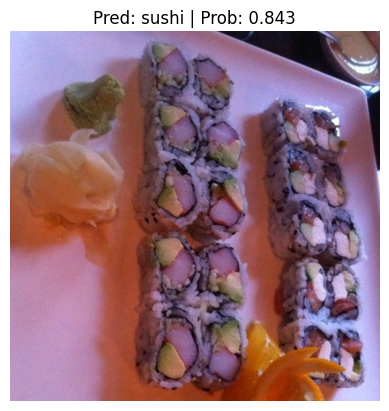

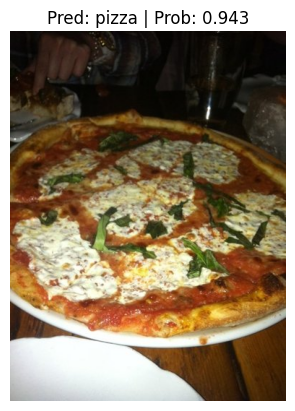

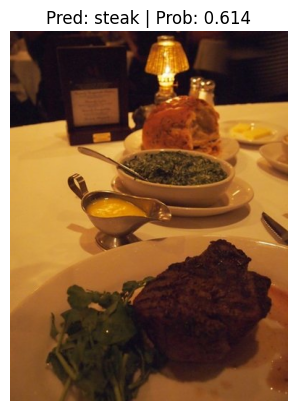

In [60]:
# Import function to make predictions on images and plot them
from going_modular.going_modular.predictions import pred_and_plot_image

# Get a random list of 3 images from 20% test set
import random
num_images_to_plot = 3
test_image_path_list = list(Path("/content/data/pizza_steak_sushi_20_percent/test").glob("*/*.jpg"))
test_image_path_sample = random.sample(population=test_image_path_list,
                                       k=num_images_to_plot)

# Iterate through random test image paths, make predictions on them and plot
for image_path in test_image_path_sample:
  pred_and_plot_image(model=best_model,
                      image_path=image_path,
                      class_names=class_names,
                      image_size=(224,224))



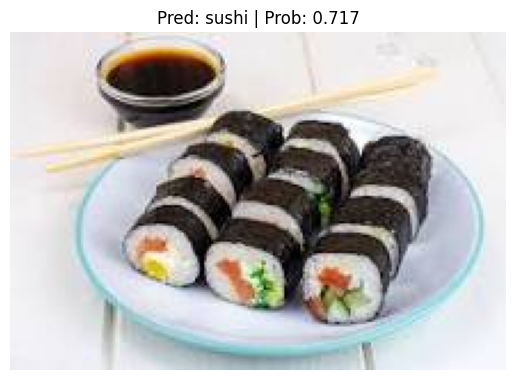

In [65]:
# Predicting on custom image

# setup custom image path
custom_image_path = "/content/data/download (1).jfif"

pred_and_plot_image(model=model,
                    image_path=custom_image_path,
                    class_names=class_names)

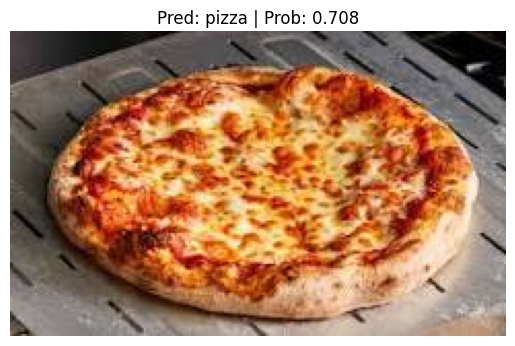

In [66]:
custom_image_path = "/content/data/download (2).jfif"

pred_and_plot_image(model=model,
                    image_path=custom_image_path,
                    class_names=class_names)

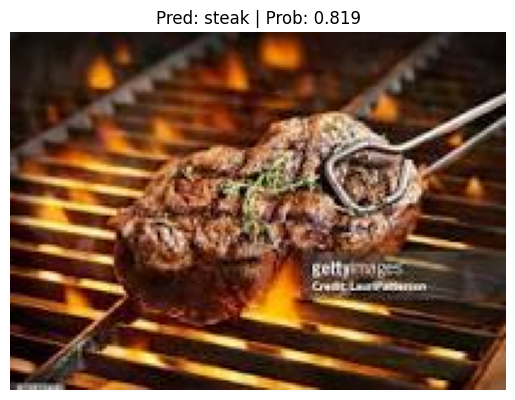

In [67]:
custom_image_path = "/content/data/download (3).jfif"

pred_and_plot_image(model=model,
                    image_path=custom_image_path,
                    class_names=class_names)